In [1]:
import numpy as np
import pandas as pd
from pysr import PySRRegressor
from scipy.integrate import solve_ivp
from lmfit import Model, Parameters
import matplotlib.pyplot as plt

#Have nice axes with LaTeX
plt.rcParams["text.usetex"] = True

# Define constants
G = 6.67e-11
m1, m2 = 10 * 1.9e30, 10 * 1.9e30
m = m1 + m2
qstan = m2/m1
c = 299792458

Detected IPython. Loading juliacall extension. See https://juliapy.github.io/PythonCall.jl/stable/compat/#IPython


In [2]:
# Function for the differential equation
def dydt(F: list[float], e: list[float], m1: float, m2: float) -> list[float]:
    eta = m1*m2/(m1+m2)**2
    m = m1+m2
    x = ((G*m*F)/c**3) ** (2/3)
    x1PN = (-11888 - 14784*eta + e**2 * (87720 - 159600*eta) + e**4 * (171038 - 141708*eta) + e**6 * (11717 - 8288*eta))/(420*(1-e**2)**(9/2))
    e1PN = -(67608 + 228704 * eta + e**2 * (-718008 + 651252*eta) + e**4 * (-125361 + 93184 * eta))/(2520*(1-e**2)**(7/2))
    phi = (1 + 7.260831042*e**2 + 5.844370473*e**4 + 0.8452020270*e**6 + 0.07580633432*e**8 + 0.002034045037*e**10) / (1 - 4.900627291*e**2 + 9.512155497*e**4 - 9.051368575*e**6 + 4.096465525*e**8 - 0.5933309609*e**10 - 0.05427399445*e**12 - 0.009020225634*e**14)
    phi_tilde = (1 + 1.893242666*e**2 - 2.708117333*e**4 + 0.6192474531*e**6 + 0.05008474620*e**8 - 0.01059040781*e**10) / (1 - 4.638007334*e**2 + 8.716680569*e**4 - 8.451197591*e**6 + 4.435922348*e**8 - 1.199023304*e**10 + 0.1398678608*e**12 - 0.004254544193*e**14)
    x1_5PN = 64/5*4*np.pi*phi
    e1_5PN = 32/5*985/48*np.pi*(192/985*np.sqrt(1-e**2)/e**2 * (np.sqrt(1-e**2)*phi - phi_tilde))
    return -2*e* (G*m/c**3)**(2/3)/(3*x*F**(1/3)) * ((304 + 121*e**2)/(15*(1-e**2)**(5/2)) + e1PN * x + e1_5PN*x**(3/2)) / ((192 + 584 * e**2 + 74 * e**4)/(15*(1-e**2)**(7/2)) + x1PN * x + x1_5PN*x**(3/2))

In [4]:
N = 10

e0sp = np.linspace(1e-15, 0.3, N)
m1s = np.linspace(5*2*10**30, 20*2*10**30, N)
m2s = np.linspace(5*2*10**30, 20*2*10**30, N)

es = []
Fs = []
etas = []
ms = []
e0s = []
for m1 in m1s:
    for m2 in m2s:
        for e0 in e0sp:
            sol = solve_ivp(
                lambda F, y: dydt(F, y, m1=m1, m2=m2),
                [10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2))],
                [e0],
                t_eval=np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N),
            )
            etas.extend(np.repeat(m1*m2/(m1+m2)**2, N))
            ms.extend(np.repeat(m1+m2, N))
            e0s.extend(np.repeat(e0, N))
            Fs.extend(sol.t)
            es.extend(sol.y[0])

In [5]:
data = pd.DataFrame({'chi': np.asarray(Fs)/10, 'e0': np.asarray(e0s), "eta": np.asarray(etas), "m": np.asarray(ms)})

In [18]:
model = PySRRegressor(
    model_selection="accuracy",
    binary_operators=["+", "-", "*", "/", "^"], 
    unary_operators=["log", "exp"], 
    nested_constraints = {"log": {"exp": 0}, "exp": {"log": 0}},
    constraints = {"^": (-1,1)},
    maxsize = 50,
    populations = 50,
    population_size = 50,
    niterations=1000,
    precision=64,
)

In [19]:
model.fit(data, es)

c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\pysr\sr.py:1236: UserWarning: Note: Using a large maxsize for the equation search will be exponentially slower and use significant memory.
  warnings.warn(
c:\Users\aminr\Anaconda3\envs\thesis\Lib\site-packages\pysr\sr.py:1307: UserWarning: Note: it looks like you are running in Jupyter. The progress bar will be turned off.
  warnings.warn(
[ Info: Started!



Expressions evaluated per second: 0.000e+00
Head worker occupation: 0.0%
Progress: 0 / 50000 total iterations (0.000%)
Hall of Fame:
---------------------------------------------------------------------------------------------------
Complexity  Loss       Score     Equation
---------------------------------------------------------------------------------------------------
Press 'q' and then <enter> to stop execution early.

Expressions evaluated per second: 5.500e+01
Head worker occupation: 0.0%
Progress: 1 / 50000 total iterations (0.002%)
Hall of Fame:
---------------------------------------------------------------------------------------------------
Complexity  Loss       Score     Equation
3           6.139e-01  1.201e+01  y = -0.65232 * 1.15
4           5.046e-01  1.960e-01  y = -0.65232 / log(0.41404)
5           2.060e-03  5.501e+00  y = -0.18567 / (eta - chi)
7           1.340e-04  1.366e+00  y = (e0 * -0.65232) / (e0 - chi)
9           2.884e-05  7.680e-01  y = ((e0 * -0.6523

PySRRegressor.equations_ = [
	    pick     score                                           equation  \
	0         0.000000                                0.03753049653109324   
	1         0.012590                            log(1.0319644139453688)   
	2         6.318334                                           e0 / chi   
	3         0.352343                (e0 / chi) + -0.0016274275491003402   
	4         0.102089  e0 * ((1.0158923976414322 / chi) - 0.012428905...   
	5         0.097149  (e0 / (0.22172084351766605 + (chi ^ 1.13274485...   
	6         1.092562  e0 / (((chi ^ 1.1328303657985044) - (e0 * chi)...   
	7         0.009730  (e0 / (((chi ^ 1.131462182005511) - (e0 * chi)...   
	8         0.012204  (-8.573015496214608e-6 * chi) + (e0 / (((chi ^...   
	9         0.000271  (-8.573015496214608e-6 * (e0 + chi)) + (e0 / (...   
	10        0.007486  ((-8.573015496214608e-6 * exp(e0)) * chi) + (e...   
	11        0.003113  (0.0003708015026939068 / log(e0)) + (e0 / ((((...   
	12        0.016987  (e0 / (e0 + ((chi ^ 1.1316584116211776) - (chi...   
	13        0.001574  (e0 / (e0 + ((chi ^ 1.1316584116211776) - (chi...   
	14        0.035058  (((((log(chi) / ((chi / e0) - chi)) ^ 1.511448...   
	15        0.000503  (((((log(chi) / ((chi / exp(e0)) / e0)) ^ 1.51...   
	16        0.035477  ((((((log(chi) / ((chi / e0) / e0)) / 0.218777...   
	17        0.014153  (((((((log(chi) ^ 1.203758203105061) / (chi / ...   
	18        0.001751  (((((((log(chi) ^ 1.203758203105061) / (chi / ...   
	19        0.000225  (((((((log(chi) ^ 1.1563035691029016) / (((chi...   
	20        0.011604  ((e0 * (((((e0 * log(chi)) / (chi + 1.46448857...   
	21        0.004817  ((e0 * (((((e0 * log(chi)) / (chi + exp(e0))) ...   
	22        0.000525  ((e0 * (((((e0 * log(chi)) / (chi + exp(e0 - -...   
	23        0.000028  ((e0 * ((((((e0 * log(chi)) - -0.0001414987151...   
	24        0.002000  ((e0 * ((((((e0 - -0.05569192814954673) * log(...   
	25        0.003434  ((e0 * ((((((e0 - -0.05569192814954673) * log(...   
	26  >>>>  0.007371  ((e0 * ((((((e0 - -0.05569192814954673) * log(...   
	
	            loss  complexity  
	0   2.941472e-03           1  
	1   2.904672e-03           2  
	2   5.236963e-06           3  
	3   2.588442e-06           5  
	4   2.110402e-06           7  
	5   1.737731e-06           9  
	6   1.954319e-07          11  
	7   1.916657e-07          13  
	8   1.870441e-07          15  
	9   1.869428e-07          17  
	10  1.855485e-07          18  
	11  1.843970e-07          20  
	12  1.812911e-07          21  
	13  1.807211e-07          23  
	14  1.744953e-07          24  
	15  1.744074e-07          25  
	16  1.683285e-07          26  
	17  1.636306e-07          28  
	18  1.630585e-07          30  
	19  1.630218e-07          31  
	20  1.611410e-07          32  
	21  1.595961e-07          34  
	22  1.594285e-07          36  
	23  1.594196e-07          38  
	24  1.587831e-07          40  
	25  1.576962e-07          42  
	26  1.565381e-07          43  
]

In [20]:
model.sympy()

e0*(e0 + ((e0 + 0.05569192814954673)*log(chi)/((eta*exp(-2.9754641003171908*e0**2))**e0*(chi + 0.99986400587383349)))**1.5116660660160037 + 1)/(chi**1.16034958000838 + e0) + 0.00013600337420614442

In [21]:
def pysrfit(e0, F, m1, m2):
    chi = F/10
    eta = m1*m2/(m1+m2)**2
    e = e0*(e0 + ((eta*np.exp(-2.9754641003171908*e0**2)**(-e0)*(e0+0.05569192814954673)*np.log(chi))/(chi+0.99986400587383349))**1.5116660660160037 + 1)/(chi**1.16034958000838 + e0) + 0.00013600337420614442
    return e

In [22]:
def expansion(e0, F, m1, m2):
    chi = F/10
    x = ((G*(m1+m2)*F)/c**3) ** (2/3)
    eta = m1*m2/(m1+m2)**2
    D0 = e0*chi**(-19/18) + 3323/1824 * e0**3*(chi**(-19/18) - chi**(-19/6)) + e0**5 * (15994231/6653952*chi**(-19/18) - 11042329/1108992*chi**(-19/6) + 50259743/6653952*chi**(-95/18))
    D2 = ((2833/2016 - 197/72*eta)*(-chi**(-19/18) + chi**(-31/18)))*e0 + ((-9414059/3677184 + 654631/131328*eta)*chi**(-19/18) + (386822573/47803392 - 1482433/131328*eta)*chi**(-31/18) + (11412055/5311488 - 378697/43776*eta)*chi**(-19/6) + (-9414059/1225728 + 654631/43776*eta)*chi**(-23/6))*e0**3 + ((-45311656423/13414367232 + 3150863507/479084544*eta)*chi**(-19/18) + (3061519891285/174386774016 - 11147601665/479084544*eta)*chi**(-31/18) + (37922258765/3229384704 - 1258410131/26615808*eta)*chi**(-19/6) + (-699589093187/9688154112 + 3092267495/26615808*eta)*chi**(-23/6) + (-1182747028465/174386774016 + 24493152461/479084544*eta)*chi**(-95/18) + (711929259595/13414367232 - 49505846855/479084544*eta)*chi**(-107/18))*e0**5
    D3 = 377*np.pi/144*(-chi**(-19/18) + chi**(-37/18))*e0 + (-1252771*np.pi/262656*chi**(-19/18) + 1315151*np.pi/131328*chi**(-37/18) + 396797*np.pi/43776*chi**(-19/6) - 1252771*np.pi/87552*chi**(-25/6))*e0**3 + (-6029825087*np.pi/958169088*chi**(-19/18) + 607032981553*np.pi/27786903552*chi**(-37/18) + 1318556431*np.pi/26615808*chi**(-19/6) - 1422200801*np.pi/13307904*chi**(-25/6) - 1586634546601*np.pi/27786903552*chi**(-95/18) + 94739615555*np.pi/958169088*chi**(-113/18))*e0**5
    return D0 + D2*x + D3*x**(3/2)

In [24]:
N = 1000
m1 = m2 = 5*2*10**30
initialEccentricities = [0.001, 0.05, 0.1, 0.2, 0.3]
F = np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N)

# Solve ewuations numerically
solutions = []
for e0 in initialEccentricities:
    sol = solve_ivp(
        lambda F, y: dydt(F, y, m1, m2),
        [10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2))],
        [e0],
        t_eval=np.linspace(10, c**3 / (6 ** (3 / 2) * np.pi * G * (m1+m2)), N),
    )
    solutions.append(sol.y[0])

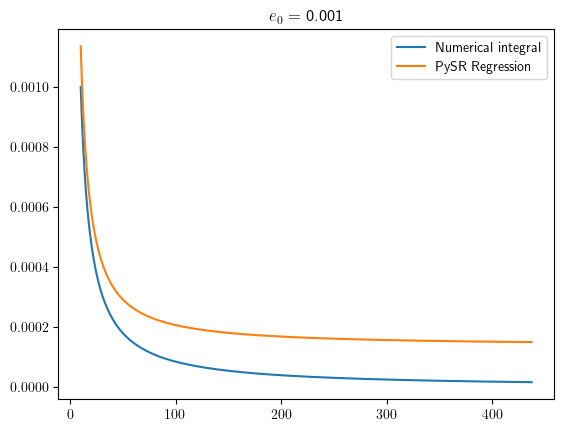

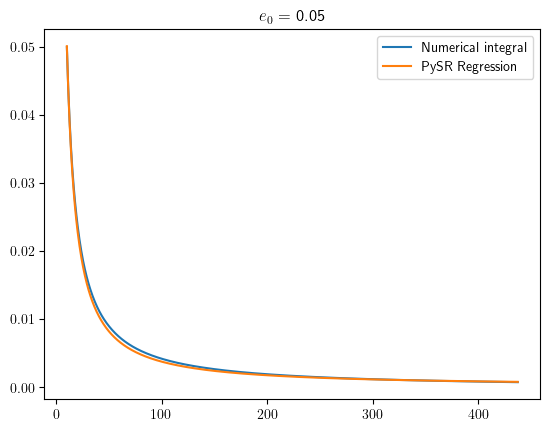

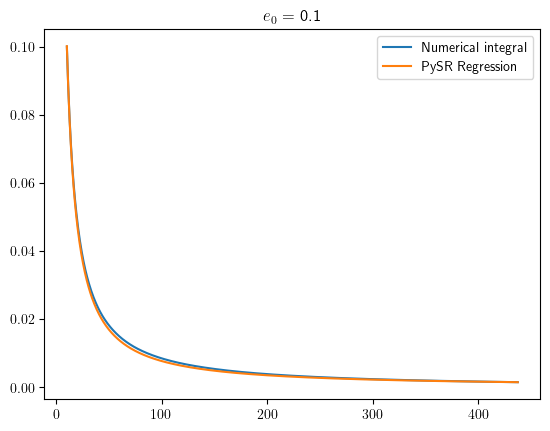

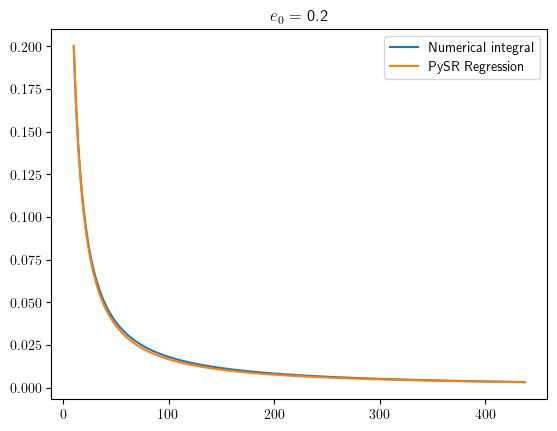

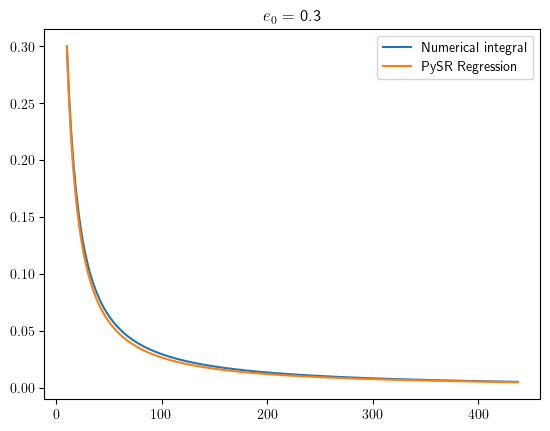

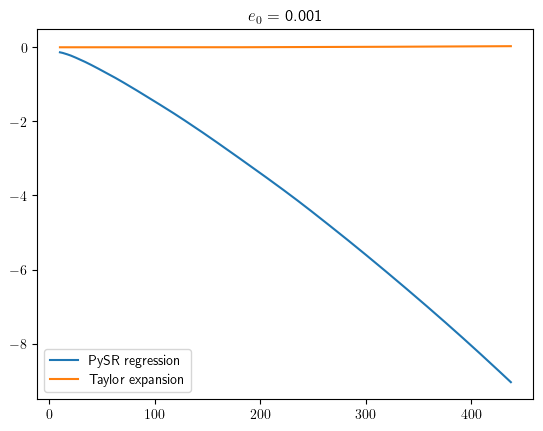

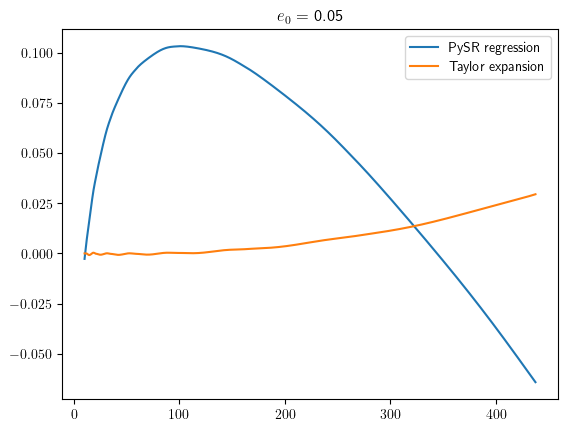

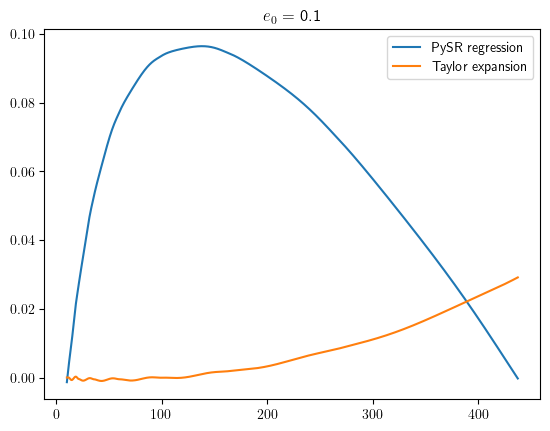

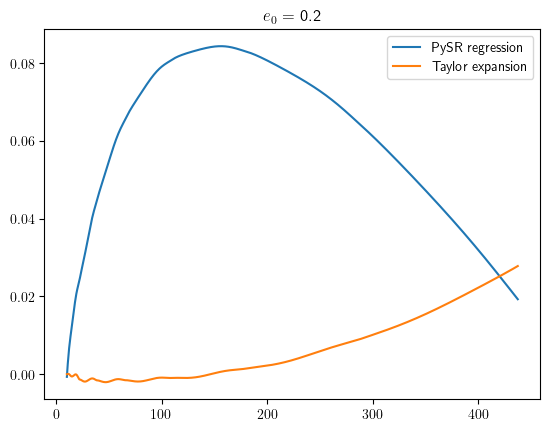

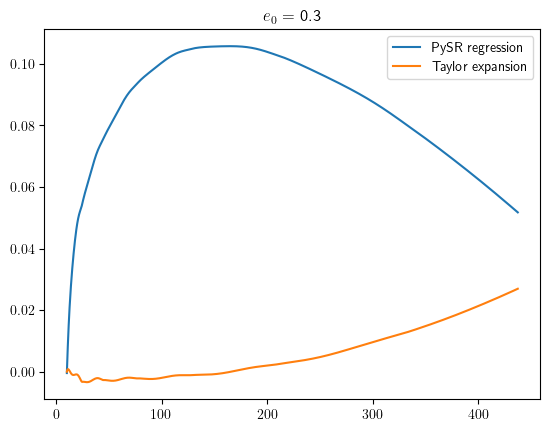

In [25]:
for i, e0 in enumerate(initialEccentricities):
    plt.plot(F, solutions[i], label = "Numerical integral")
    plt.plot(F, pysrfit(np.repeat(e0, N), F, m1, m2), label="PySR Regression")
    plt.title(rf"$e_0$ = {e0}")
    plt.legend()
    plt.show()

for i, e0 in enumerate(initialEccentricities):
    plt.plot(F, (solutions[i] - pysrfit(np.repeat(e0, N), F, m1, m2)) / solutions[i], label = "PySR regression")
    plt.plot(F, (solutions[i] - expansion(np.repeat(e0, N), F, m1, m2)) / solutions[i], label = "Taylor expansion")
    plt.legend()
    plt.title(rf"$e_0$ = {e0}")
    plt.show()